In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from plotly.offline import iplot
import plotly as py
import plotly.tools as tls
import sys
import cufflinks
import cufflinks as cf
%matplotlib inline

In [2]:
py.offline.init_notebook_mode(connected=True)
cf.go_offline()

In [3]:
df=pd.read_csv(r"E:\pizza_sales.csv")

In [4]:
df

,pizza_id,order_id,pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_category,pizza_ingredients,pizza_name
0,1,1,hawaiian_m,1,2015-01-01,11:38:36,13.25,13.25,M,Classic,"Sliced Ham, Pineapple, Mozzarella Cheese",The Hawaiian Pizza
1,2,2,classic_dlx_m,1,2015-01-01,11:57:40,16.00,16.00,M,Classic,"Pepperoni, Mushrooms, Red Onions, Red Peppers,...",The Classic Deluxe Pizza
2,3,2,five_cheese_l,1,2015-01-01,11:57:40,18.50,18.50,L,Veggie,"Mozzarella Cheese, Provolone Cheese, Smoked Go...",The Five Cheese Pizza
3,4,2,ital_supr_l,1,2015-01-01,11:57:40,20.75,20.75,L,Supreme,"Calabrese Salami, Capocollo, Tomatoes, Red Oni...",The Italian Supreme Pizza
4,5,2,mexicana_m,1,2015-01-01,11:57:40,16.00,16.00,M,Veggie,"Tomatoes, Red Peppers, Jalapeno Peppers, Red O...",The Mexicana Pizza
...,...,...,...,...,...,...,...,...,...,...,...,...
48615,48616,21348,ckn_alfredo_m,1,2015-12-31,21:23:10,16.75,16.75,M,Chicken,"Chicken, Red Onions, Red Peppers, Mushrooms, A...",The Chicken Alfredo Pizza
48616,48617,21348,four_cheese_l,1,2015-12-31,21:23:10,17.95,17.95,L,Veggie,"Ricotta Cheese, Gorgonzola Piccante Cheese, Mo...",The Four Cheese Pizza
48617,48618,21348,napolitana_s,1,2015-12-31,21:23:10,12.00,12.00,S,Classic,"Tomatoes, Anchovies, Green Olives, Red Onions,...",The Napolitana Pizza
48618,48619,21349,mexicana_l,1,2015-12-31,22:09:54,20.25,20.25,L,Veggie,"Tomatoes, Red Peppers, Jalapeno Peppers, Red O...",The Mexicana Pizza


In [5]:
df.isnull().sum()

pizza_id             0
order_id             0
pizza_name_id        0
quantity             0
order_date           0
order_time           0
unit_price           0
total_price          0
pizza_size           0
pizza_category       0
pizza_ingredients    0
pizza_name           0
dtype: int64

<Axes: >

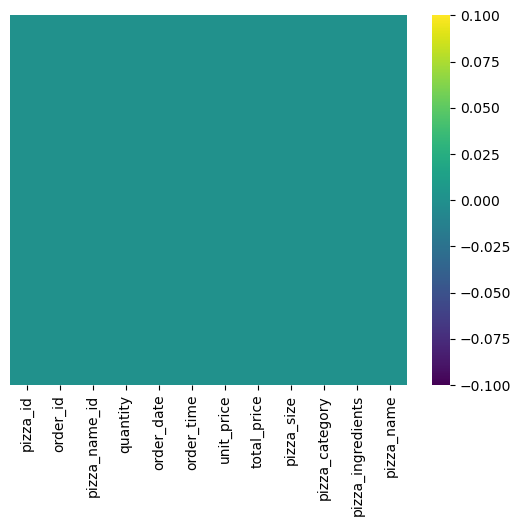

In [6]:
# figsize(12,8)
sns.heatmap(df.isnull(), yticklabels=False, cmap = 'viridis')

In [7]:
df.duplicated().sum()

0

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48620 entries, 0 to 48619
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   pizza_id           48620 non-null  int64  
 1   order_id           48620 non-null  int64  
 2   pizza_name_id      48620 non-null  object 
 3   quantity           48620 non-null  int64  
 4   order_date         48620 non-null  object 
 5   order_time         48620 non-null  object 
 6   unit_price         48620 non-null  float64
 7   total_price        48620 non-null  float64
 8   pizza_size         48620 non-null  object 
 9   pizza_category     48620 non-null  object 
 10  pizza_ingredients  48620 non-null  object 
 11  pizza_name         48620 non-null  object 
dtypes: float64(2), int64(3), object(7)
memory usage: 4.5+ MB


In [9]:
df.dtypes

pizza_id               int64
order_id               int64
pizza_name_id         object
quantity               int64
order_date            object
order_time            object
unit_price           float64
total_price          float64
pizza_size            object
pizza_category        object
pizza_ingredients     object
pizza_name            object
dtype: object

In [10]:
df.columns

Index(['pizza_id', 'order_id', 'pizza_name_id', 'quantity', 'order_date',
       'order_time', 'unit_price', 'total_price', 'pizza_size',
       'pizza_category', 'pizza_ingredients', 'pizza_name'],
      dtype='object')

In [11]:
df.shape

(48620, 12)

In [12]:
df.describe()

,pizza_id,order_id,quantity,unit_price,total_price
count,48620.000000,48620.000000,48620.000000,48620.000000,48620.000000
mean,24310.500000,10701.479761,1.019622,16.494132,16.821474
std,14035.529381,6180.119770,0.143077,3.621789,4.437398
min,1.000000,1.000000,1.000000,9.750000,9.750000
25%,12155.750000,5337.000000,1.000000,12.750000,12.750000
50%,24310.500000,10682.500000,1.000000,16.500000,16.500000
75%,36465.250000,16100.000000,1.000000,20.250000,20.500000
max,48620.000000,21350.000000,4.000000,35.950000,83.000000


In [13]:
df.pizza_name_id.unique()

array(['hawaiian_m', 'classic_dlx_m', 'five_cheese_l', 'ital_supr_l',
       'mexicana_m', 'thai_ckn_l', 'ital_supr_m', 'prsc_argla_l',
       'bbq_ckn_s', 'the_greek_s', 'spinach_supr_s', 'classic_dlx_s',
       'green_garden_s', 'ital_cpcllo_l', 'ital_supr_s', 'mexicana_s',
       'spicy_ital_l', 'spin_pesto_l', 'veggie_veg_s', 'mexicana_l',
       'southw_ckn_l', 'bbq_ckn_l', 'cali_ckn_l', 'cali_ckn_m',
       'pepperoni_l', 'cali_ckn_s', 'ckn_pesto_l', 'big_meat_s',
       'soppressata_l', 'four_cheese_l', 'napolitana_s', 'calabrese_m',
       'four_cheese_m', 'ital_veggie_s', 'mediterraneo_m',
       'peppr_salami_s', 'spinach_fet_l', 'napolitana_l', 'sicilian_l',
       'ital_cpcllo_m', 'southw_ckn_s', 'bbq_ckn_m', 'pepperoni_m',
       'prsc_argla_s', 'sicilian_m', 'veggie_veg_l', 'ckn_alfredo_s',
       'pepperoni_s', 'green_garden_l', 'green_garden_m', 'pep_msh_pep_l',
       'hawaiian_s', 'peppr_salami_m', 'ckn_alfredo_m', 'peppr_salami_l',
       'spin_pesto_s', 'thai_ckn_m'

In [14]:
df.pizza_size.unique()

array(['M', 'L', 'S', 'XL', 'XXL'], dtype=object)

In [15]:
df.pizza_category.unique()

array(['Classic', 'Veggie', 'Supreme', 'Chicken'], dtype=object)

In [16]:
df.pizza_ingredients.unique()

array(['Sliced Ham, Pineapple, Mozzarella Cheese',
       'Pepperoni, Mushrooms, Red Onions, Red Peppers, Bacon',
       'Mozzarella Cheese, Provolone Cheese, Smoked Gouda Cheese, Romano Cheese, Blue Cheese, Garlic',
       'Calabrese Salami, Capocollo, Tomatoes, Red Onions, Green Olives, Garlic',
       'Tomatoes, Red Peppers, Jalapeno Peppers, Red Onions, Cilantro, Corn, Chipotle Sauce, Garlic',
       'Chicken, Pineapple, Tomatoes, Red Peppers, Thai Sweet Chilli Sauce',
       'Prosciutto di San Daniele, Arugula, Mozzarella Cheese',
       'Barbecued Chicken, Red Peppers, Green Peppers, Tomatoes, Red Onions, Barbecue Sauce',
       'Kalamata Olives, Feta Cheese, Tomatoes, Garlic, Beef Chuck Roast, Red Onions',
       'Spinach, Red Onions, Pepperoni, Tomatoes, Artichokes, Kalamata Olives, Garlic, Asiago Cheese',
       'Spinach, Mushrooms, Tomatoes, Green Olives, Feta Cheese',
       'Capocollo, Red Peppers, Tomatoes, Goat Cheese, Garlic, Oregano',
       'Capocollo, Tomatoes, Goat C

In [17]:
df.pizza_name.unique()

array(['The Hawaiian Pizza', 'The Classic Deluxe Pizza',
       'The Five Cheese Pizza', 'The Italian Supreme Pizza',
       'The Mexicana Pizza', 'The Thai Chicken Pizza',
       'The Prosciutto and Arugula Pizza', 'The Barbecue Chicken Pizza',
       'The Greek Pizza', 'The Spinach Supreme Pizza',
       'The Green Garden Pizza', 'The Italian Capocollo Pizza',
       'The Spicy Italian Pizza', 'The Spinach Pesto Pizza',
       'The Vegetables + Vegetables Pizza', 'The Southwest Chicken Pizza',
       'The California Chicken Pizza', 'The Pepperoni Pizza',
       'The Chicken Pesto Pizza', 'The Big Meat Pizza',
       'The Soppressata Pizza', 'The Four Cheese Pizza',
       'The Napolitana Pizza', 'The Calabrese Pizza',
       'The Italian Vegetables Pizza', 'The Mediterranean Pizza',
       'The Pepper Salami Pizza', 'The Spinach and Feta Pizza',
       'The Sicilian Pizza', 'The Chicken Alfredo Pizza',
       'The Pepperoni Mushroom  and Peppers Pizza',
       'The Pepperoni  Mushroo

In [18]:
from sklearn.preprocessing import LabelEncoder
labelencoder=LabelEncoder()

In [19]:
df['pizza_name_id']=labelencoder.fit_transform(df['pizza_name_id'])
df['pizza_ingredients']=labelencoder.fit_transform(df['pizza_ingredients'])
df['pizza_name']=labelencoder.fit_transform(df['pizza_name'])

In [20]:
df['pizza_size']=df['pizza_size'].map({ 'M': 1,'L': 2, 'S': 3, 'XL': 4, 'XXL': 5})
df['pizza_category']=df['pizza_category'].map({ 'Classic': 1,'Veggie': 2, 'Supreme': 3, 'Chicken': 4})

In [21]:
df.head(3)

,pizza_id,order_id,pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_category,pizza_ingredients,pizza_name
0,1,1,27,1,2015-01-01,11:38:36,13.25,13.25,1,1,23,12
1,2,2,18,1,2015-01-01,11:57:40,16.00,16.00,1,1,20,7
2,3,2,20,1,2015-01-01,11:57:40,18.50,18.50,2,2,17,8


In [22]:
df.columns

Index(['pizza_id', 'order_id', 'pizza_name_id', 'quantity', 'order_date',
       'order_time', 'unit_price', 'total_price', 'pizza_size',
       'pizza_category', 'pizza_ingredients', 'pizza_name'],
      dtype='object')

In [23]:
df.iplot(x = 'pizza_name', y = 'total_price', kind = 'bar')

In [24]:
cf.set_config_file(theme='solar')
df.iplot(x = 'pizza_category', y = 'unit_price', mode = 'markers', xTitle = 'unit_price', yTitle = 'pizza_category')

In [98]:
df.iplot(x = 'pizza_name', y = 'total_price', z = 'pizza_category', kind = 'scatter3d')

In [99]:
df.iplot(x = 'pizza_name', y = 'total_price', z = 'unit_price', kind = 'bubble3d', size = 'pizza_name')

In [100]:
df.head()

,pizza_id,order_id,pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_category,pizza_ingredients,pizza_name,Day,Month,Year,hours,minutes,seconds,weekday
0,1,1,27,1,2015-01-01,11:38:36,13.25,13.25,1,1,23,12,2015,January,1,11,38,36,Thursday
1,2,2,18,1,2015-01-01,11:57:40,16.00,16.00,1,1,20,7,2015,January,1,11,57,40,Thursday
2,3,2,20,1,2015-01-01,11:57:40,18.50,18.50,2,2,17,8,2015,January,1,11,57,40,Thursday
3,4,2,32,1,2015-01-01,11:57:40,20.75,20.75,2,3,4,14,2015,January,1,11,57,40,Thursday
4,5,2,42,1,2015-01-01,11:57:40,16.00,16.00,1,2,31,17,2015,January,1,11,57,40,Thursday


In [101]:
df.tail()

,pizza_id,order_id,pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_category,pizza_ingredients,pizza_name,Day,Month,Year,hours,minutes,seconds,weekday
48615,48616,21348,12,1,2015-12-31,21:23:10,16.75,16.75,1,4,9,5,2015,December,31,21,23,10,Thursday
48616,48617,21348,21,1,2015-12-31,21:23:10,17.95,17.95,2,2,22,9,2015,December,31,21,23,10,Thursday
48617,48618,21348,46,1,2015-12-31,21:23:10,12.00,12.00,3,1,30,18,2015,December,31,21,23,10,Thursday
48618,48619,21349,41,1,2015-12-31,22:09:54,20.25,20.25,2,2,31,17,2015,December,31,22,9,54,Thursday
48619,48620,21350,2,1,2015-12-31,23:02:05,12.75,12.75,3,4,2,0,2015,December,31,23,2,5,Thursday


In [102]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48620 entries, 0 to 48619
Data columns (total 19 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   pizza_id           48620 non-null  int64  
 1   order_id           48620 non-null  int64  
 2   pizza_name_id      48620 non-null  int32  
 3   quantity           48620 non-null  int64  
 4   order_date         48620 non-null  object 
 5   order_time         48620 non-null  object 
 6   unit_price         48620 non-null  float64
 7   total_price        48620 non-null  float64
 8   pizza_size         48620 non-null  int64  
 9   pizza_category     48620 non-null  int64  
 10  pizza_ingredients  48620 non-null  int32  
 11  pizza_name         48620 non-null  int32  
 12  Day                48620 non-null  int32  
 13  Month              48620 non-null  object 
 14  Year               48620 non-null  int32  
 15  hours              48620 non-null  int32  
 16  minutes            486

In [103]:
# Feature Engineering Process
df['Day']=df['order_date'].str.split('-').str[0]
df['Month']=df['order_date'].str.split('-').str[1]
df['Year']=df['order_date'].str.split('-').str[2]

In [104]:
df

,pizza_id,order_id,pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_category,pizza_ingredients,pizza_name,Day,Month,Year,hours,minutes,seconds,weekday
0,1,1,27,1,2015-01-01,11:38:36,13.25,13.25,1,1,23,12,2015,01,01,11,38,36,Thursday
1,2,2,18,1,2015-01-01,11:57:40,16.00,16.00,1,1,20,7,2015,01,01,11,57,40,Thursday
2,3,2,20,1,2015-01-01,11:57:40,18.50,18.50,2,2,17,8,2015,01,01,11,57,40,Thursday
3,4,2,32,1,2015-01-01,11:57:40,20.75,20.75,2,3,4,14,2015,01,01,11,57,40,Thursday
4,5,2,42,1,2015-01-01,11:57:40,16.00,16.00,1,2,31,17,2015,01,01,11,57,40,Thursday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48615,48616,21348,12,1,2015-12-31,21:23:10,16.75,16.75,1,4,9,5,2015,12,31,21,23,10,Thursday
48616,48617,21348,21,1,2015-12-31,21:23:10,17.95,17.95,2,2,22,9,2015,12,31,21,23,10,Thursday
48617,48618,21348,46,1,2015-12-31,21:23:10,12.00,12.00,3,1,30,18,2015,12,31,21,23,10,Thursday
48618,48619,21349,41,1,2015-12-31,22:09:54,20.25,20.25,2,2,31,17,2015,12,31,22,9,54,Thursday


In [105]:
df['Day']=df['Day'].astype(int)
df['Month']=df['Month'].astype(int)
df['Year']=df['Year'].astype(int)

In [106]:
df.dtypes

pizza_id               int64
order_id               int64
pizza_name_id          int32
quantity               int64
order_date            object
order_time            object
unit_price           float64
total_price          float64
pizza_size             int64
pizza_category         int64
pizza_ingredients      int32
pizza_name             int32
Day                    int32
Month                  int32
Year                   int32
hours                  int32
minutes                int32
seconds                int32
weekday               object
dtype: object

In [107]:
# Feature Engineering Process
df['hours']=df['order_time'].str.split(':').str[0]
df['minutes']=df['order_time'].str.split(':').str[1]
df['seconds']=df['order_time'].str.split(':').str[2]

In [108]:
df

,pizza_id,order_id,pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_category,pizza_ingredients,pizza_name,Day,Month,Year,hours,minutes,seconds,weekday
0,1,1,27,1,2015-01-01,11:38:36,13.25,13.25,1,1,23,12,2015,1,1,11,38,36,Thursday
1,2,2,18,1,2015-01-01,11:57:40,16.00,16.00,1,1,20,7,2015,1,1,11,57,40,Thursday
2,3,2,20,1,2015-01-01,11:57:40,18.50,18.50,2,2,17,8,2015,1,1,11,57,40,Thursday
3,4,2,32,1,2015-01-01,11:57:40,20.75,20.75,2,3,4,14,2015,1,1,11,57,40,Thursday
4,5,2,42,1,2015-01-01,11:57:40,16.00,16.00,1,2,31,17,2015,1,1,11,57,40,Thursday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48615,48616,21348,12,1,2015-12-31,21:23:10,16.75,16.75,1,4,9,5,2015,12,31,21,23,10,Thursday
48616,48617,21348,21,1,2015-12-31,21:23:10,17.95,17.95,2,2,22,9,2015,12,31,21,23,10,Thursday
48617,48618,21348,46,1,2015-12-31,21:23:10,12.00,12.00,3,1,30,18,2015,12,31,21,23,10,Thursday
48618,48619,21349,41,1,2015-12-31,22:09:54,20.25,20.25,2,2,31,17,2015,12,31,22,09,54,Thursday


In [109]:
df['hours']=df['hours'].astype(int)
df['minutes']=df['minutes'].astype(int)
df['seconds']=df['seconds'].astype(int)

In [110]:
df.dtypes

pizza_id               int64
order_id               int64
pizza_name_id          int32
quantity               int64
order_date            object
order_time            object
unit_price           float64
total_price          float64
pizza_size             int64
pizza_category         int64
pizza_ingredients      int32
pizza_name             int32
Day                    int32
Month                  int32
Year                   int32
hours                  int32
minutes                int32
seconds                int32
weekday               object
dtype: object

In [111]:
# df.drop('order_date', axis=1, inplace=True)
# df.drop('order_time', axis=1, inplace=True)

In [112]:
df.dtypes

pizza_id               int64
order_id               int64
pizza_name_id          int32
quantity               int64
order_date            object
order_time            object
unit_price           float64
total_price          float64
pizza_size             int64
pizza_category         int64
pizza_ingredients      int32
pizza_name             int32
Day                    int32
Month                  int32
Year                   int32
hours                  int32
minutes                int32
seconds                int32
weekday               object
dtype: object

In [113]:
df

,pizza_id,order_id,pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_category,pizza_ingredients,pizza_name,Day,Month,Year,hours,minutes,seconds,weekday
0,1,1,27,1,2015-01-01,11:38:36,13.25,13.25,1,1,23,12,2015,1,1,11,38,36,Thursday
1,2,2,18,1,2015-01-01,11:57:40,16.00,16.00,1,1,20,7,2015,1,1,11,57,40,Thursday
2,3,2,20,1,2015-01-01,11:57:40,18.50,18.50,2,2,17,8,2015,1,1,11,57,40,Thursday
3,4,2,32,1,2015-01-01,11:57:40,20.75,20.75,2,3,4,14,2015,1,1,11,57,40,Thursday
4,5,2,42,1,2015-01-01,11:57:40,16.00,16.00,1,2,31,17,2015,1,1,11,57,40,Thursday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48615,48616,21348,12,1,2015-12-31,21:23:10,16.75,16.75,1,4,9,5,2015,12,31,21,23,10,Thursday
48616,48617,21348,21,1,2015-12-31,21:23:10,17.95,17.95,2,2,22,9,2015,12,31,21,23,10,Thursday
48617,48618,21348,46,1,2015-12-31,21:23:10,12.00,12.00,3,1,30,18,2015,12,31,21,23,10,Thursday
48618,48619,21349,41,1,2015-12-31,22:09:54,20.25,20.25,2,2,31,17,2015,12,31,22,9,54,Thursday


<Axes: >

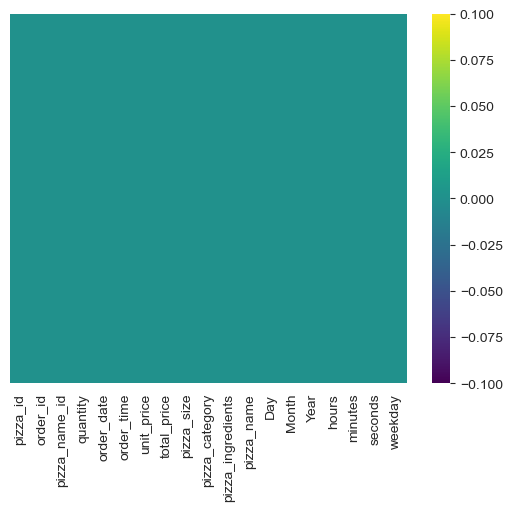

In [114]:
# figsize(12,8)
sns.heatmap(df.isnull(), yticklabels=False, cmap = 'viridis')

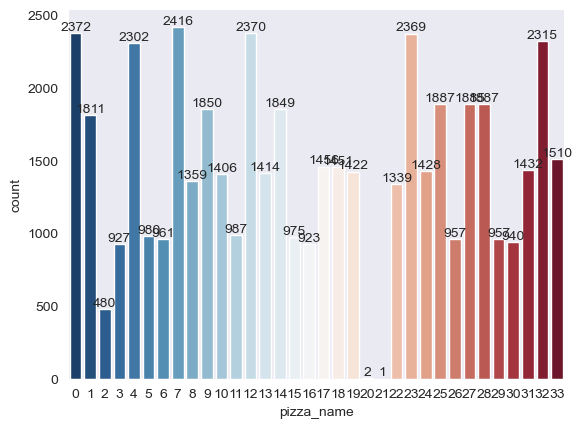

In [115]:
sns.set_style('dark') # sns is for seaborn library, style is dark, you can select other styles - google it
ax = sns.countplot(x = 'pizza_name', data=df, palette = 'RdBu_r')
for bars in ax.containers: # counts on top of bar (common for all type of counts)
    ax.bar_label(bars)

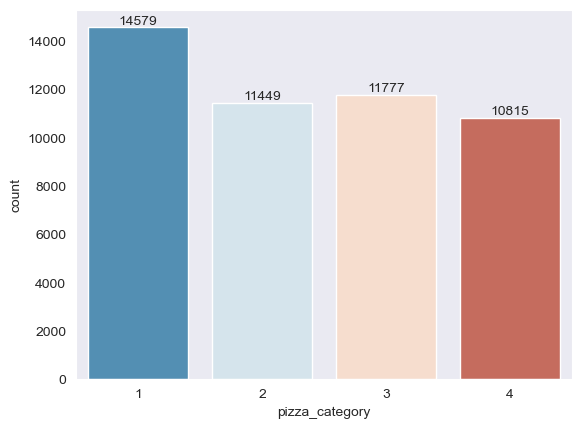

In [116]:
sns.set_style('dark') # sns is for seaborn library, style is dark, you can select other styles - google it
ax = sns.countplot(x = 'pizza_category', data=df, palette = 'RdBu_r')
for bars in ax.containers: # counts on top of bar (common for all type of counts)
    ax.bar_label(bars)

quantity
1    47693
2      903
3       21
4        3
Name: count, dtype: int64

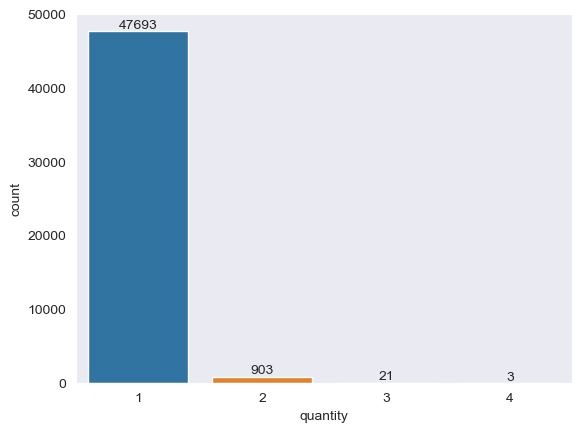

In [117]:
ax=sns.countplot(x= 'quantity', data=df)
for bars in ax.containers: # counts on top of bar (common for all type of counts)
    ax.bar_label(bars)
df['quantity'].value_counts()

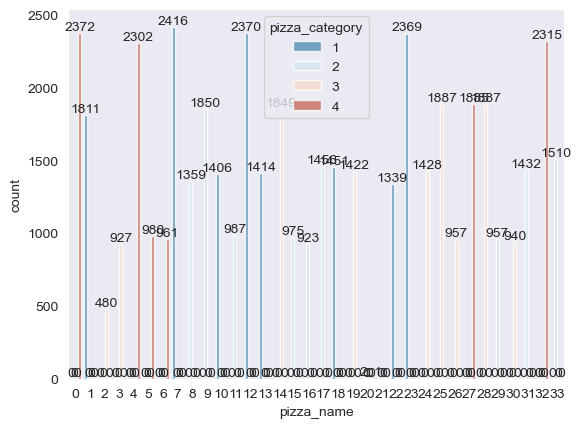

In [118]:
sns.set_style('dark') # sns is for seaborn library, style is dark, you can select other styles - google it
ax = sns.countplot(x = 'pizza_name', hue = 'pizza_category', data=df, palette = 'RdBu_r', alpha = 0.8)
for bars in ax.containers: # counts on top of bar (common for all type of counts)
    ax.bar_label(bars)

<Axes: >

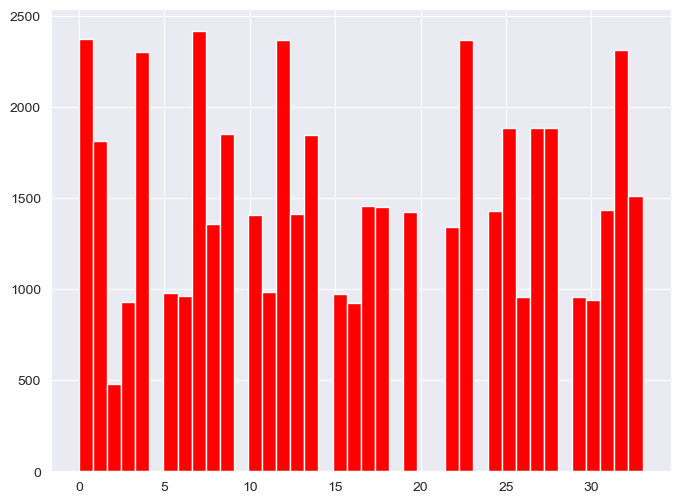

In [119]:
df['pizza_name'].hist(color='red', bins=40, figsize=(8,6))

<Axes: xlabel='pizza_name', ylabel='total_price'>

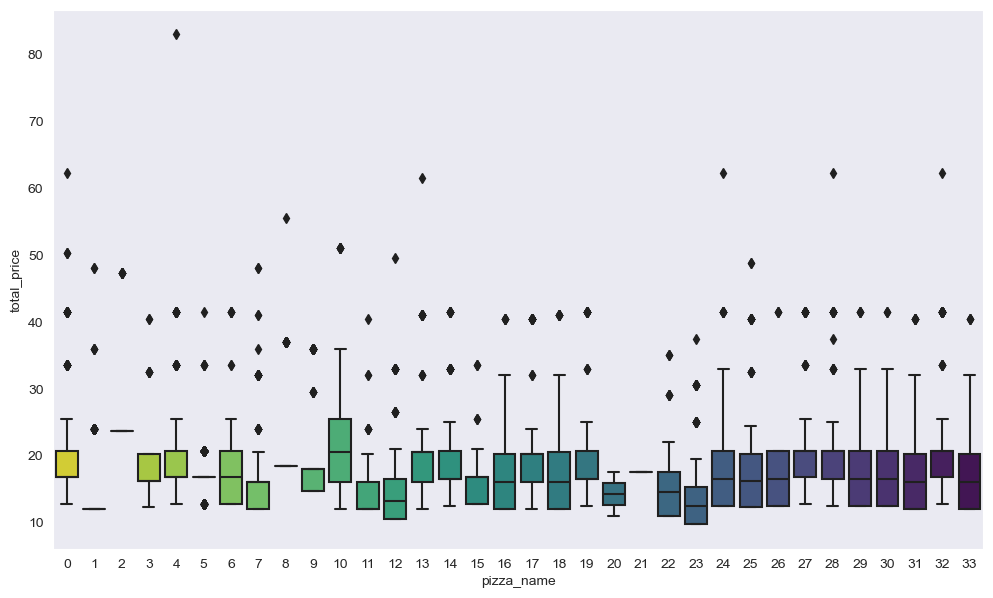

In [120]:
plt.figure(figsize=(12,7))
sns.boxplot(x= 'pizza_name', y = 'total_price', data = df, palette = 'viridis_r')

D:\ANACONDA\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning:

The figure layout has changed to tight



<Figure size 1500x1500 with 0 Axes>

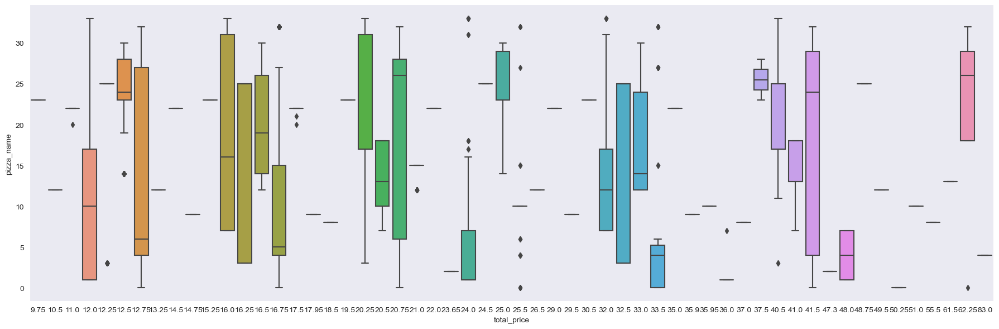

In [121]:
plt.figure(figsize=(15,15))
sns.catplot(y="pizza_name", x = "total_price", data=df.sort_values("total_price", ascending=True), kind= "box", height=6, aspect=3)

D:\ANACONDA\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning:

The figure layout has changed to tight



<Figure size 1200x1200 with 0 Axes>

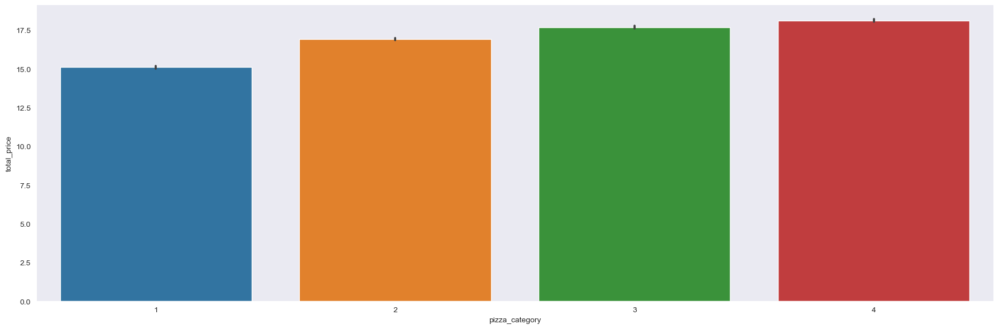

In [122]:
plt.figure(figsize=(12,12))
sns.catplot(y="total_price", x = "pizza_category", data=df.sort_values("total_price", ascending=False), kind= "bar", height=6, aspect=3)

<Axes: >

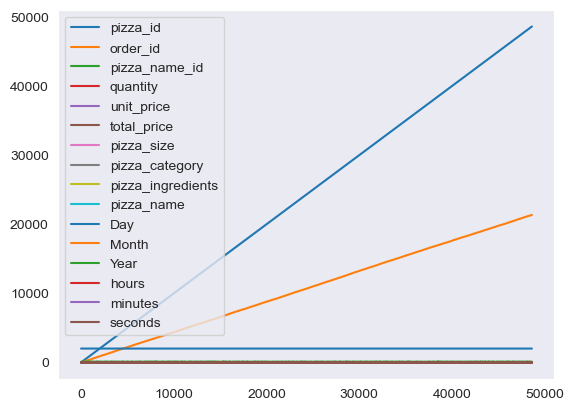

In [123]:
df.plot()

<Axes: >

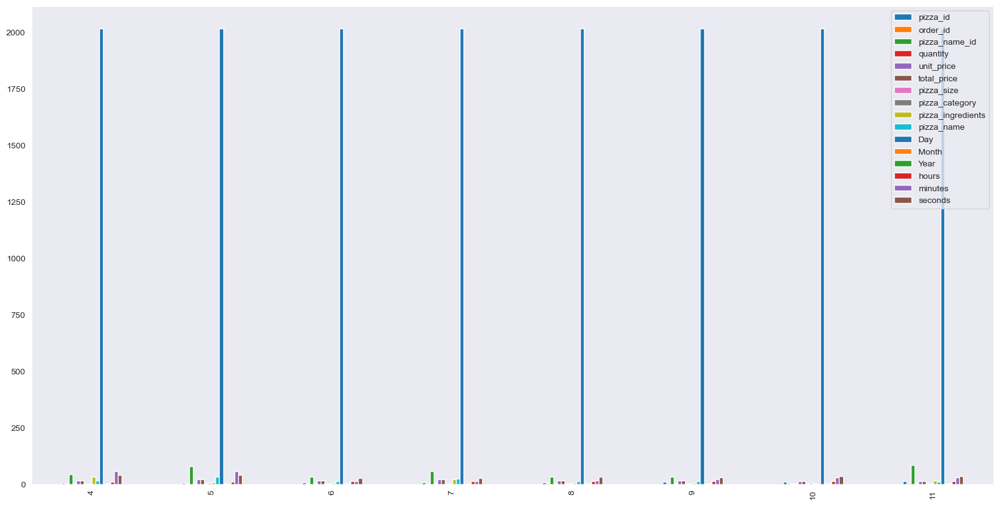

In [124]:
df.iloc[4:12].plot(kind = 'bar', figsize = (20,10))

<Axes: ylabel='Frequency'>

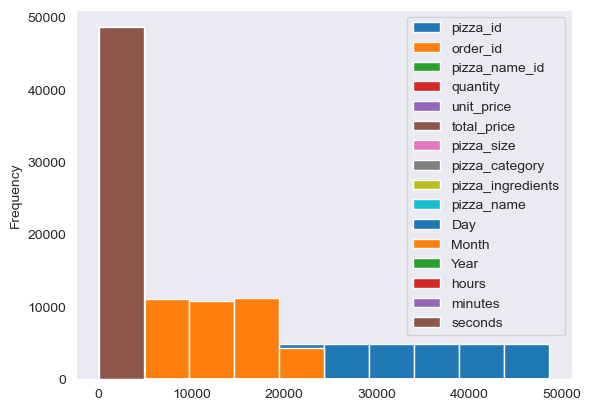

In [125]:
df.plot(kind='hist')

<Axes: ylabel='Frequency'>

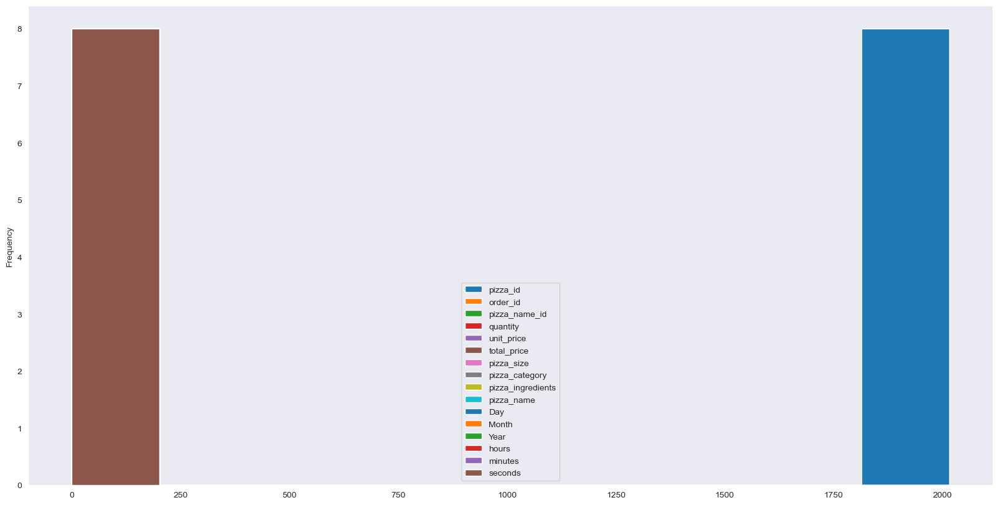

In [126]:
df.iloc[4:12].plot(kind='hist', figsize = (20,10))

<Axes: ylabel='Frequency'>

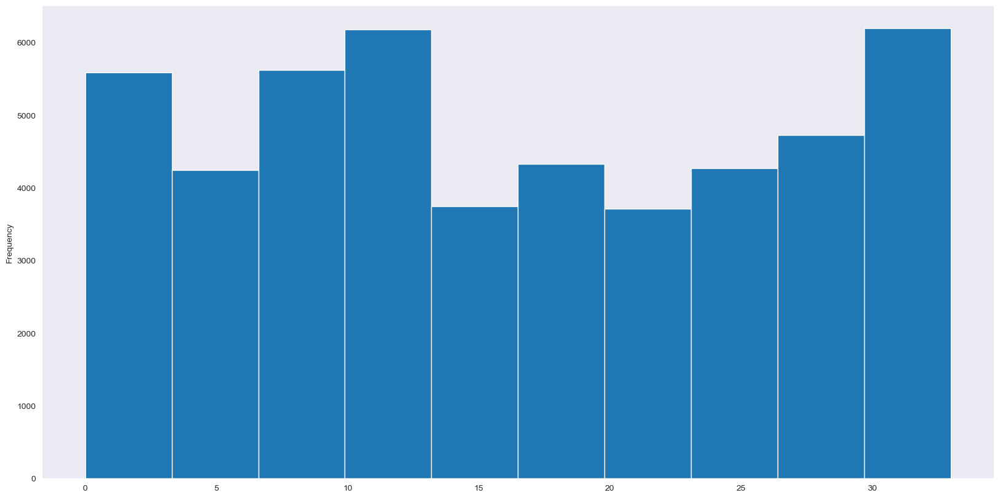

In [127]:
df['pizza_name'].plot(kind ='hist', figsize =(20,10))

<Axes: >

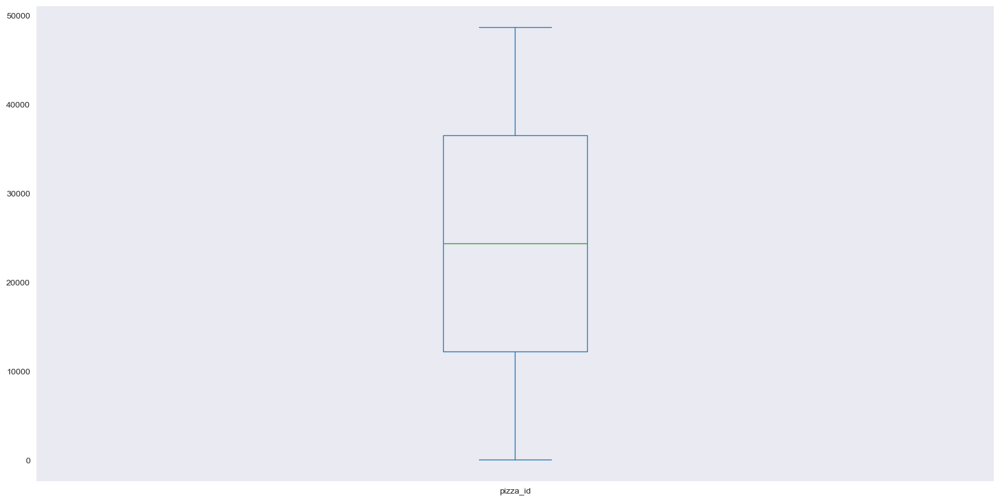

In [128]:
df['pizza_id']. plot(kind = 'box', figsize = (20,10))

<Axes: >

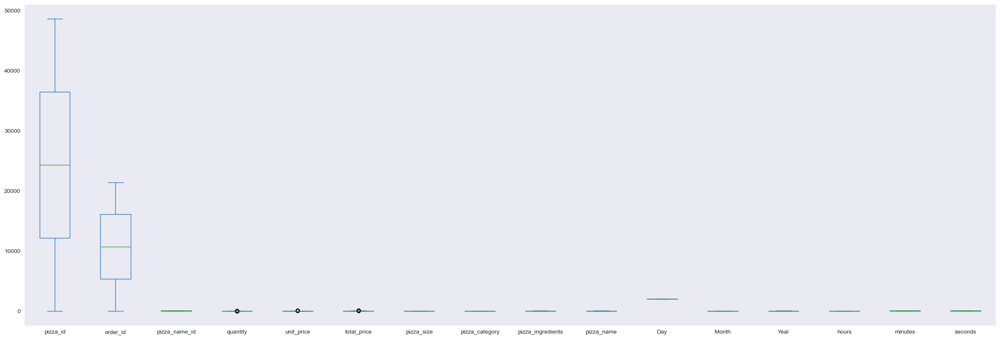

In [129]:
df.plot(kind = 'box', figsize = (30,10))

array([[<Axes: title={'center': 'pizza_id'}>,
        <Axes: title={'center': 'order_id'}>,
        <Axes: title={'center': 'pizza_name_id'}>,
        <Axes: title={'center': 'quantity'}>],
       [<Axes: title={'center': 'unit_price'}>,
        <Axes: title={'center': 'total_price'}>,
        <Axes: title={'center': 'pizza_size'}>,
        <Axes: title={'center': 'pizza_category'}>],
       [<Axes: title={'center': 'pizza_ingredients'}>,
        <Axes: title={'center': 'pizza_name'}>,
        <Axes: title={'center': 'Day'}>,
        <Axes: title={'center': 'Month'}>],
       [<Axes: title={'center': 'Year'}>,
        <Axes: title={'center': 'hours'}>,
        <Axes: title={'center': 'minutes'}>,
        <Axes: title={'center': 'seconds'}>]], dtype=object)

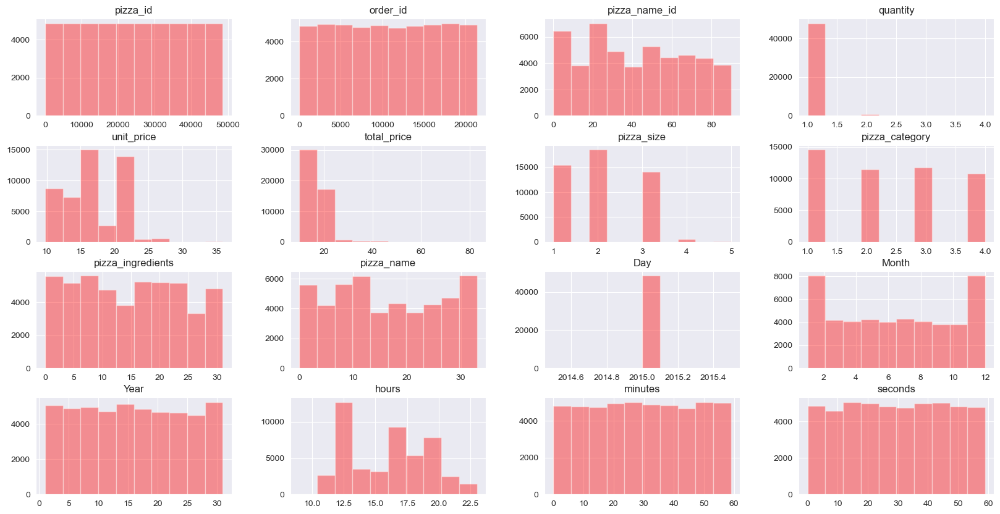

In [130]:
df.hist(figsize=(20,10), color = 'r', alpha = 0.4)

<Axes: >

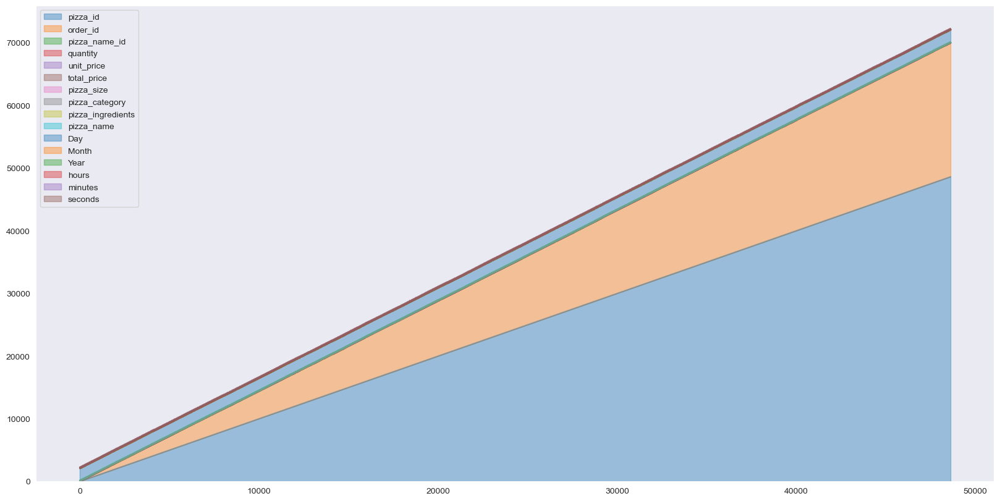

In [131]:
df.plot(kind = 'area', figsize = (20,10), alpha = 0.4, stacked = True)

<Axes: xlabel='pizza_name', ylabel='quantity'>

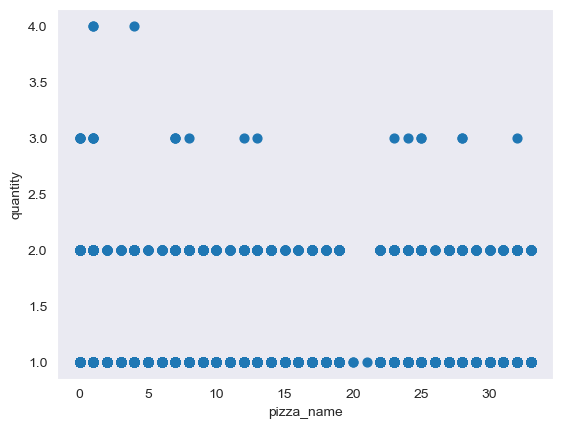

In [132]:
df.plot.scatter(x = 'pizza_name', y = 'quantity', s = 40)

<Axes: xlabel='pizza_name', ylabel='total_price'>

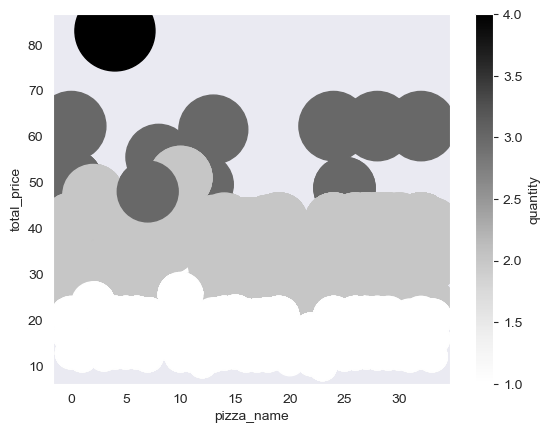

In [133]:
df.plot.scatter(x= 'pizza_name', y = 'total_price', c = 'quantity', s = df['total_price']*40)

<Axes: xlabel='pizza_name', ylabel='total_price'>

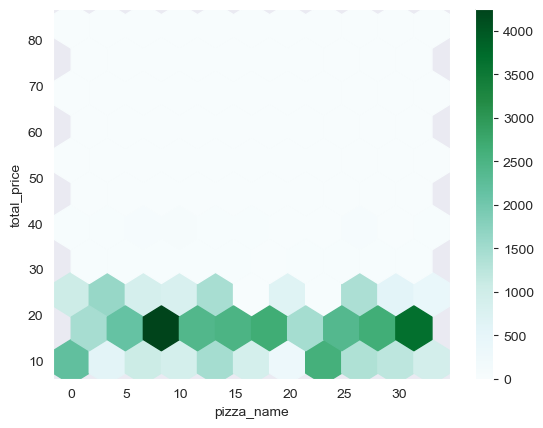

In [134]:
df.plot.hexbin(x = 'pizza_name', y = 'total_price', gridsize = 10)

# Pizza Sales Analysis

In [135]:
# Q-1. Total Revenue

In [136]:
df['total_price'].sum()

817860.05

In [137]:
# Q-2. Average Order Value

In [138]:
df1=sum(df['total_price'])
print(df1)
df2=df.order_id.nunique()
print(df2)
print(df1/df2)

817860.049999993
21350
38.307262295081635


In [139]:
# Q-3. Total Pizzas Sold

In [140]:
df['quantity'].sum()

49574

In [141]:
# Q-4. Total Orders

In [142]:
df['order_id'].nunique()

21350

In [143]:
# Q-5. Average Pizza Per Order

In [144]:
df1 = sum(df['quantity'])
print(df1)
df2=df.order_id.nunique()
print(df2)
print(df1/df2)

49574
21350
2.321967213114754


In [145]:
# Q-6. Daily Trend for Total Orders

In [146]:
df

,pizza_id,order_id,pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_category,pizza_ingredients,pizza_name,Day,Month,Year,hours,minutes,seconds,weekday
0,1,1,27,1,2015-01-01,11:38:36,13.25,13.25,1,1,23,12,2015,1,1,11,38,36,Thursday
1,2,2,18,1,2015-01-01,11:57:40,16.00,16.00,1,1,20,7,2015,1,1,11,57,40,Thursday
2,3,2,20,1,2015-01-01,11:57:40,18.50,18.50,2,2,17,8,2015,1,1,11,57,40,Thursday
3,4,2,32,1,2015-01-01,11:57:40,20.75,20.75,2,3,4,14,2015,1,1,11,57,40,Thursday
4,5,2,42,1,2015-01-01,11:57:40,16.00,16.00,1,2,31,17,2015,1,1,11,57,40,Thursday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48615,48616,21348,12,1,2015-12-31,21:23:10,16.75,16.75,1,4,9,5,2015,12,31,21,23,10,Thursday
48616,48617,21348,21,1,2015-12-31,21:23:10,17.95,17.95,2,2,22,9,2015,12,31,21,23,10,Thursday
48617,48618,21348,46,1,2015-12-31,21:23:10,12.00,12.00,3,1,30,18,2015,12,31,21,23,10,Thursday
48618,48619,21349,41,1,2015-12-31,22:09:54,20.25,20.25,2,2,31,17,2015,12,31,22,9,54,Thursday


In [147]:
df['weekday']=pd.DatetimeIndex(df['order_date']).day_name()
df['weekday'].value_counts()

weekday
Friday       8106
Saturday     7355
Thursday     7323
Wednesday    6797
Tuesday      6753
Monday       6369
Sunday       5917
Name: count, dtype: int64

In [148]:
# Q-7. Monthly Trend for Orders

In [149]:
df

,pizza_id,order_id,pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_category,pizza_ingredients,pizza_name,Day,Month,Year,hours,minutes,seconds,weekday
0,1,1,27,1,2015-01-01,11:38:36,13.25,13.25,1,1,23,12,2015,1,1,11,38,36,Thursday
1,2,2,18,1,2015-01-01,11:57:40,16.00,16.00,1,1,20,7,2015,1,1,11,57,40,Thursday
2,3,2,20,1,2015-01-01,11:57:40,18.50,18.50,2,2,17,8,2015,1,1,11,57,40,Thursday
3,4,2,32,1,2015-01-01,11:57:40,20.75,20.75,2,3,4,14,2015,1,1,11,57,40,Thursday
4,5,2,42,1,2015-01-01,11:57:40,16.00,16.00,1,2,31,17,2015,1,1,11,57,40,Thursday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48615,48616,21348,12,1,2015-12-31,21:23:10,16.75,16.75,1,4,9,5,2015,12,31,21,23,10,Thursday
48616,48617,21348,21,1,2015-12-31,21:23:10,17.95,17.95,2,2,22,9,2015,12,31,21,23,10,Thursday
48617,48618,21348,46,1,2015-12-31,21:23:10,12.00,12.00,3,1,30,18,2015,12,31,21,23,10,Thursday
48618,48619,21349,41,1,2015-12-31,22:09:54,20.25,20.25,2,2,31,17,2015,12,31,22,9,54,Thursday


In [150]:
df['Month']=pd.DatetimeIndex(df['order_date']).month_name()
df['Month'].value_counts()

Month
July         4301
May          4239
March        4186
November     4185
January      4156
August       4094
April        4067
June         4025
February     3892
December     3859
September    3819
October      3797
Name: count, dtype: int64

In [151]:
# Q-8. Percentage of Sales by Pizza Category

In [152]:
a =df.groupby('pizza_category')['total_price'].sum()
b= df['total_price'].sum()
percentage_of_sales = (a/b)*100
print(percentage_of_sales)

pizza_category
1    26.905960
2    23.682591
3    25.456311
4    23.955138
Name: total_price, dtype: float64


In [153]:
# Q-9. Percentage of Sales by Pizza Size

In [154]:
a =df.groupby('pizza_size')['total_price'].sum()
b= df['total_price'].sum()
percentage_of_sales = (a/b)*100
print(percentage_of_sales)

pizza_size
1    30.492044
2    45.890333
3    21.773468
4     1.721077
5     0.123077
Name: total_price, dtype: float64


In [155]:
# Q-10. Total Pizzas Sold by Pizza Category

In [156]:
df['pizza_category'].sum()

116068

In [157]:
# Q-11. Top 5 Pizzas by Revenue

In [158]:
df.groupby(['pizza_name'])['total_price'].sum().sort_values(ascending=False).head(5)

pizza_name
32    43434.25
0     42768.00
4     41409.50
7     38180.50
28    34831.25
Name: total_price, dtype: float64

In [159]:
# Q-12. Bottom 5 Pizzas by Revenue

In [160]:
df.groupby(['pizza_name'])['total_price'].sum().sort_values(ascending=False).tail(5)

pizza_name
30    15277.75
11    13955.75
2     11588.50
20       28.50
21       17.50
Name: total_price, dtype: float64

In [161]:
# Q-13. Top 5 Pizzas by Quantity

In [162]:
df.groupby(['pizza_name'])['quantity'].sum().sort_values(ascending=False).head(5)

pizza_name
7     2453
0     2432
12    2422
23    2418
32    2371
Name: quantity, dtype: int64

In [163]:
# Q-14. Bottom 5 Pizzas by Quantity

In [164]:
df.groupby(['pizza_name'])['quantity'].sum().sort_values(ascending=False).tail(5)

pizza_name
3     937
16    934
2     490
20      2
21      1
Name: quantity, dtype: int64

In [165]:
# Q-15. Top 5 Pizza by Total Orders

In [166]:
df.groupby(['pizza_name'])['order_id'].nunique().sort_values(ascending=False).head(5)

pizza_name
7     2329
12    2280
23    2278
0     2273
32    2225
Name: order_id, dtype: int64

In [167]:
# Q-16. Bottom 5 Pizzas by Total Orders

In [168]:
df.groupby(['pizza_name'])['order_id'].nunique().sort_values(ascending=False).tail(5)

pizza_name
30    918
16    912
2     480
20      2
21      1
Name: order_id, dtype: int64